In [1]:
# Импортируем необходимые модули

import numpy as np
import matplotlib.pyplot as plt

import plotly
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots

from ipywidgets import interact

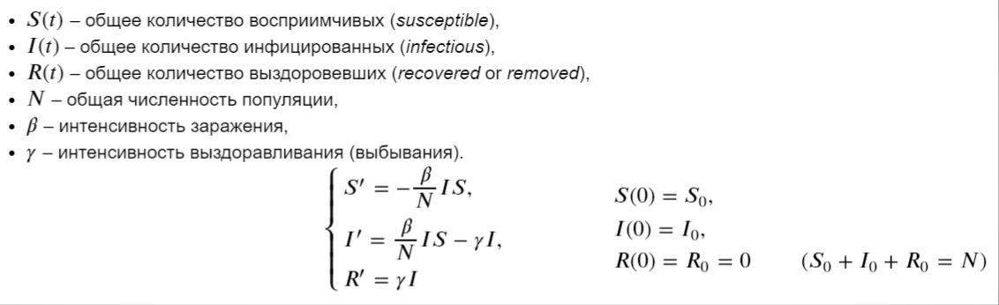

In [2]:
# Определяем функцию, вычисляющую правую часть системы

def sir_model(t, x, N, beta, gamma):
    S, I, R = x
    dS_dt = -beta*I*S/N
    dI_dt = beta*I*S/N - gamma*I
    dR_dt = gamma*I
    xdot = np.array([dS_dt, dI_dt, dR_dt])
    return xdot

In [35]:
# Задаём параметры и начальные условия


beta = 0.32
gamma = 0.12

N = 200000
I0 = 100
R0 = 0
S0 = N - I0 - R0

t0 = 0
tf = 100
dt = 0.01


x0 = np.array([S0, I0, R0])

f = lambda t, x: sir_model(t, x, N, beta, gamma)

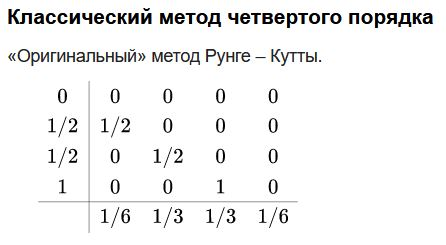

In [36]:
# Реализуем метод Рунге-Кутты 4-го порядка

"""
t0 и tf - начальный и конечный момент времени
dt - шаг времени
x0 - массив значений в начальный момент времени

"""

def RungeKutta4(f, x0, t0, tf, dt):
    
    # Массив всех t от t0 до tf с шагом dt
    
    t = np.arange(t0, tf, dt)
    nt = t.size
    
    # Массив из nx строк и nt столбцов, пока что заполненный нулями
    nx = x0.size
    x = np.zeros((nx, nt))
    
    # Заполняем первый столбец (при t = 0) начальными значениями
    
    x[:,0] = x0
    
    for k in range(nt - 1):
        
        # Коэфициенты для метода РК
        
        k1 = f(t[k], x[:,k])
        k2 = f(t[k] + dt/2, x[:,k] + dt*k1/2)
        k3 = f(t[k] + dt/2, x[:,k] + dt*k2/2)
        k4 = f(t[k] + dt, x[:,k] + dt*k3)
        
        dx = dt*(k1 +2*k2 +2*k3 +k4)/6
        
        # Запись новых значений в текущий момент времени
        
        x[:, k+1] = x[:,k] + dx
        
    return x, t
    

In [5]:
# Решение методом Рунге-Кутты 4-го порядка

x, t = RungeKutta4(f, x0, t0, tf, dt)


In [6]:
# Визуализируем решения для метода Рунге-Кутты 4-го порядка
def plot(x, t):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=t, y=x[0,:], name="Восприимчивые (S)"))
    fig.add_trace(go.Scatter(x=t, y=x[1,:], name="Заражённые (I)"))
    fig.add_trace(go.Scatter(x=t, y=x[2,:], name="Выздоровевшие (R)"))
    fig.update_layout(legend_orientation="h", xaxis_title="Время (t)", margin=dict(l=0, r=0, t=30, b=0))
    fig.show()

    fig1 = go.Figure(data = [go.Scatter3d(x=x[0,:], y=x[1,:], z=x[2,:])])

    fig1.update_layout(scene = dict(
                        xaxis_title="Восприимчивые (S)",
                        yaxis_title="Заражённые (I)",
                        zaxis_title="Выздоровевшие (R)"),
                        width=700,
                         margin=dict(l=0, r=0, t=30, b=0))

    fig1.show()

plot(x, t)


In [7]:
# Добавим интерактив для метода Рунге-Кутты 4-го порядка

def interact_rk4(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x, t = RungeKutta4(f, x0, t0, tf, dt)
    plot(x, t)
    
interact(interact_rk4, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(0, N, 10), tf=(10, 1000, 1))
    
    

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_rk4(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

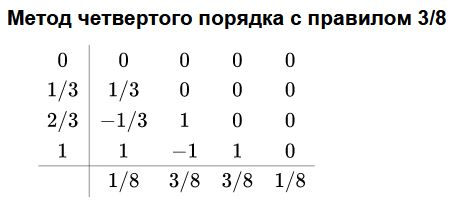

In [8]:
# Реализуем метод Рунге-Кутты 4-го порядка с правилом 3/8

"""
t0 и tf - начальный и конечный момент времени
dt - шаг времени
x0 - массив значений в начальный момент времени

"""

def RungeKutta_3_8(f, x0, t0, tf, dt):
    
    # Массив всех t от t0 до tf с шагом dt
    
    t = np.arange(t0, tf, dt)
    nt = t.size
    
    # Массив из nx строк и nt столбцов, пока что заполненный нулями
    nx = x0.size
    x = np.zeros((nx, nt))
    
    # Заполняем первый столбец (при t = 0) начальными значениями
    
    x[:,0] = x0
    
    for k in range(nt - 1):
        
        # Коэфициенты для метода РК
        
        k1 = f(t[k], x[:,k])
        k2 = f(t[k] + dt/3, x[:,k] + dt*k1/3)
        k3 = f(t[k] + 2*dt/3, x[:,k] - dt*k1/3 + dt*k2)
        k4 = f(t[k] + dt, x[:,k] + dt*k1 - dt*k2 +dt*k3)
        
        dx = dt*(k1 +3*k2 +3*k3 +k4)/8
        
        # Запись новых значений в текущий момент времени
        
        x[:, k+1] = x[:,k] + dx
        
    return x, t
    

In [9]:
# Решение методом Рунге-Кутты 4-го порядка с правилом 3/8

x, t = RungeKutta_3_8(f, x0, t0, tf, dt)

In [10]:
# Визуализируем решение методом Рунге-Кутты 4-го порядка с правилом 3/8

plot(x, t)

In [11]:
# Добавим интерактив для метода Рунге-Кутты 4-го порядка с правилом 3/8

def interact_rk38(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x, t = RungeKutta_3_8(f, x0, t0, tf, dt)
    plot(x, t)
    
interact(interact_rk38, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_rk38(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

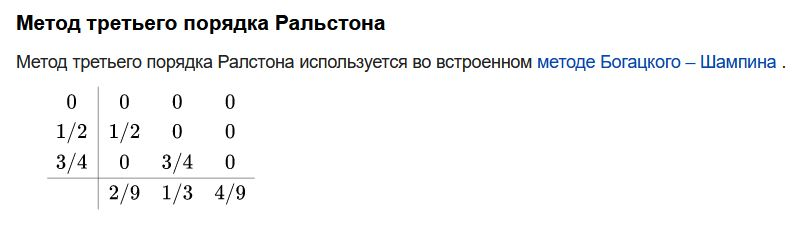

In [12]:
# Реализуем метод Ральстона 3-го порядка

"""
t0 и tf - начальный и конечный момент времени
dt - шаг времени
x0 - массив значений в начальный момент времени

"""

def Rolstone3(f, x0, t0, tf, dt):
    
    # Массив всех t от t0 до tf с шагом dt
    
    t = np.arange(t0, tf, dt)
    nt = t.size
    
    # Массив из nx строк и nt столбцов, пока что заполненный нулями
    nx = x0.size
    x = np.zeros((nx, nt))
    
    # Заполняем первый столбец (при t = 0) начальными значениями
    
    x[:,0] = x0
    
    for k in range(nt - 1):
        
        # Коэфициенты для метода 
        
        k1 = f(t[k], x[:,k])
        k2 = f(t[k] + dt/2, x[:,k] + dt*k1/2)
        k3 = f(t[k] + 3*dt/4, x[:,k] + 3*dt*k2/4)
        
        dx = dt*(2*k1/3 + k2 + 4*k3/3)/3
        
        # Запись новых значений в текущий момент времени
        
        x[:, k+1] = x[:,k] + dx
        
    return x, t

In [13]:
# Решение методом Ральстона 3-го порядка

x, t = Rolstone3(f, x0, t0, tf, dt)

In [14]:
# Визуализируем решение методом Ральстона 3-го порядка

plot(x, t)

In [15]:
# Добавим интерактив для метода Ральстона 3-го порядка

def interact_r3(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x, t = Rolstone3(f, x0, t0, tf, dt)
    plot(x, t)
    
interact(interact_r3, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_r3(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

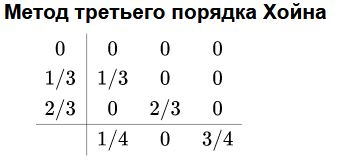

In [16]:
"""
t0 и tf - начальный и конечный момент времени
dt - шаг времени
x0 - массив значений в начальный момент времени

"""

def Hoyne3(f, x0, t0, tf, dt):
    
    # Массив всех t от t0 до tf с шагом dt
    
    t = np.arange(t0, tf, dt)
    nt = t.size
    
    # Массив из nx строк и nt столбцов, пока что заполненный нулями
    nx = x0.size
    x = np.zeros((nx, nt))
    
    # Заполняем первый столбец (при t = 0) начальными значениями
    
    x[:,0] = x0
    
    for k in range(nt - 1):
        
        # Коэфициенты для метода 
        
        k1 = f(t[k], x[:,k])
        k2 = f(t[k] + dt/3, x[:,k] + dt*k1/3)
        k3 = f(t[k] + 2*dt/3, x[:,k] + 2*dt*k2/3)
        
        dx = dt*(1*k1/4 + 0*k2 + 3*k3/4)
        
        # Запись новых значений в текущий момент времени
        
        x[:, k+1] = x[:,k] + dx
        
    return x, t

In [17]:
x, t = Hoyne3(f, x0, t0, tf, dt)

In [18]:
plot(x, t)

In [19]:
def interact_h3(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x, t = Hoyne3(f, x0, t0, tf, dt)
    plot(x, t)
    
interact(interact_h3, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_h3(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

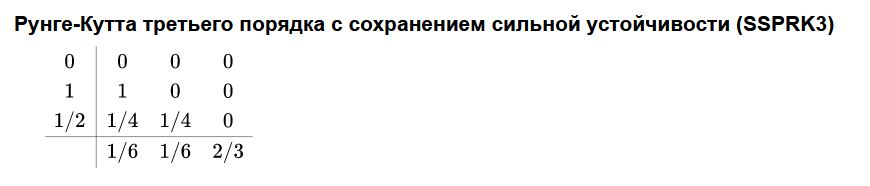

In [28]:
def ssprk3(f, x0, t0, tf, dt):
    
    # Массив всех t от t0 до tf с шагом dt
    
    t = np.arange(t0, tf, dt)
    nt = t.size
    
    # Массив из nx строк и nt столбцов, пока что заполненный нулями
    nx = x0.size
    x = np.zeros((nx, nt))

    
    # Заполняем первый столбец (при t = 0) начальными значениями
    
    x[:,0] = x0
    
    for k in range(nt - 1):
        
        # Коэфициенты для метода 
        
        k1 = f(t[k], x[:,k])
        k2 = f(t[k] + dt, x[:,k] + dt*k1)
        k3 = f(t[k] + dt/2, x[:,k] + dt*k1/4 + dt*k2/4)
        
        dx = dt*(k1/2 + k2/2 + 2*k3)/3
        
        # Запись новых значений в текущий момент времени
        
        x[:, k+1] = x[:,k] + dx
        
    return x, t

In [21]:
x, t = ssprk3(f, x0, t0, tf, dt)

In [22]:
plot(x, t)

In [23]:
def interact_ssprk3(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x, t = ssprk3(f, x0, t0, tf, dt)
    plot(x, t)
    
interact(interact_ssprk3, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_ssprk3(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

In [29]:
x1, t1 = RungeKutta4(f, x0, t0, tf, dt)
x2, t2 = RungeKutta_3_8(f, x0, t0, tf, dt)
x3, t3 = ssprk3(f, x0, t0, tf, dt)
x4, t4 = Hoyne3(f, x0, t0, tf, dt)
x5, t5 = Rolstone3(f, x0, t0, tf, dt)

In [56]:
def compare_solutions(t0, tf, dt, x1, x2):
    nx = x0.size
    t = np.arange(t0, tf, dt)
    nt = t.size
    x = np.zeros((nx, nt))
    for k in range(nt - 1):
        x[:, k] = x1[:,k] - x2[:,k]
#         print(x[:, k])
    return x, t

# Сравнение методов РК 4-го порядка и РК 4-го пор. 3/8

In [66]:
def interact_comp1(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x1, t1 = RungeKutta4(f, x0, t0, tf, dt)
    x2, t2 = RungeKutta_3_8(f, x0, t0, tf, dt)
    x, t = compare_solutions(t0, tf, dt, x1, x2)
    plot(x, t)
    
interact(interact_comp1, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_comp1(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

# Cравнение метода РК 4-го порядка и метода РК 3-го порядка с сохранением сильной устойчивости

In [69]:
def interact_comp2(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x1, t1 = RungeKutta4(f, x0, t0, tf, dt)
    x2, t2 = ssprk3(f, x0, t0, tf, dt)
    x, t = compare_solutions(t0, tf, dt, x1, x2)
    plot(x, t)
    
interact(interact_comp1, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_comp1(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

# Cравнение метода РК 4-го порядка и метода Хойна 3-го порядка 

In [70]:
def interact_comp3(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x1, t1 = RungeKutta4(f, x0, t0, tf, dt)
    x2, t2 = Hoyne3(f, x0, t0, tf, dt)
    x, t = compare_solutions(t0, tf, dt, x1, x2)
    plot(x, t)
    
interact(interact_comp1, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_comp1(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>

# Cравнение метода РК 4-го порядка и метода Ральстона 3-го порядка

In [71]:
def interact_comp3(beta=0.32, gamma=0.12, N=200000, I0=100, tf = 100):
    dt = 0.01
    R0=0
    S0 = N-I0-R0
    t0 = 0
    x0 = np.array([S0, I0, R0])
    f = lambda t, x: sir_model(t, x, N, beta, gamma)
    x1, t1 = RungeKutta4(f, x0, t0, tf, dt)
    x2, t2 = Rolstone3(f, x0, t0, tf, dt)
    x, t = compare_solutions(t0, tf, dt, x1, x2)
    plot(x, t)
    
interact(interact_comp1, beta=(0, 2, 0.02), gamma=(0, 0.5, 0.01), N=(100, 400000, 100), I0=(10, N, 10), tf=(10, 1000, 1))

interactive(children=(FloatSlider(value=0.32, description='beta', max=2.0, step=0.02), FloatSlider(value=0.12,…

<function __main__.interact_comp1(beta=0.32, gamma=0.12, N=200000, I0=100, tf=100)>